In [1]:
import galsim
from matplotlib import pyplot as plt
plt.style.use(['dark_background'])
%matplotlib inline

import numpy as np
from SpecklePSF import SpeckleSeries
import pickle
import pandas as pd

scratchdir = '/global/cscratch1/sd/chebert/'
saveDir = './../../Fits/hsmFits/'

# find all image files in the scratch directory
fileNames = ! ls /global/cscratch1/sd/chebert/rawSpeckles/ | grep 'img' 
fileNames = [f for f in fileNames if f not in ['img_a_004.fits', 'img_b_004.fits', # frames with no signal 
                                               'img_a_388.fits', 'img_b_388.fits', # frames with no signal 
                                               'img_a_389.fits', 'img_b_389.fits', # frames with no signal 
                                               'img_a_381.fits', 'img_b_381.fits', # frames with no signal 
                                               'img_a_207.fits', 'img_b_207.fits', # frames with no signal 
                                               # b frame: PSF moves suddenly by 60 pixels after 200 frames 
                                               'img_a_218.fits', 'img_b_218.fits', 
                                               'img_a_234.fits', 'img_b_234.fits']] # frames with smudges
NFiles = len(fileNames)

In [2]:
import helperFunctions as helper
from astropy.io import fits

In [3]:
with open('./../../Fits/centerOfMassB.p', 'rb') as file:
    comDictB = pickle.load(file)
with open('./../../Fits/fwhmB.p', 'rb') as file:
    fwhmDictB = pickle.load(file)

with open('./../../Fits/centerOfMassA.p', 'rb') as file:
    comDictA = pickle.load(file)
with open('./../../Fits/fwhmA.p', 'rb') as file:
    fwhmDictA = pickle.load(file)
    
with open('./../eConversionWithGain.p', 'rb') as file:
    convWithGain = pickle.load(file)
    convWithGain = dict(convWithGain)

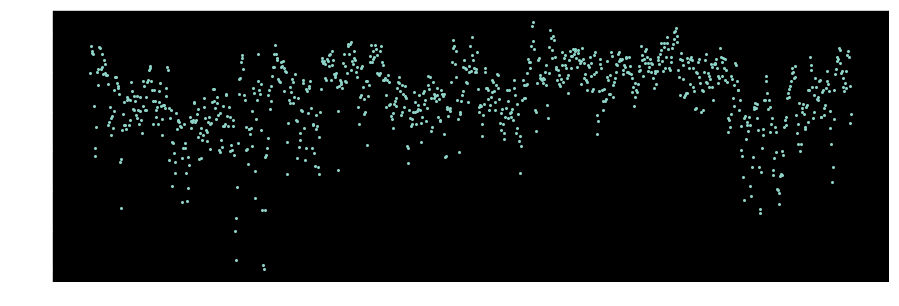

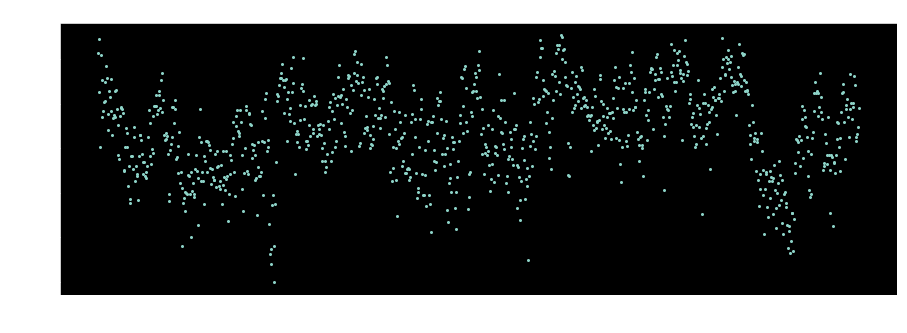

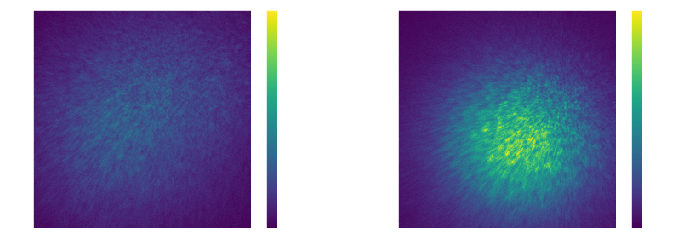

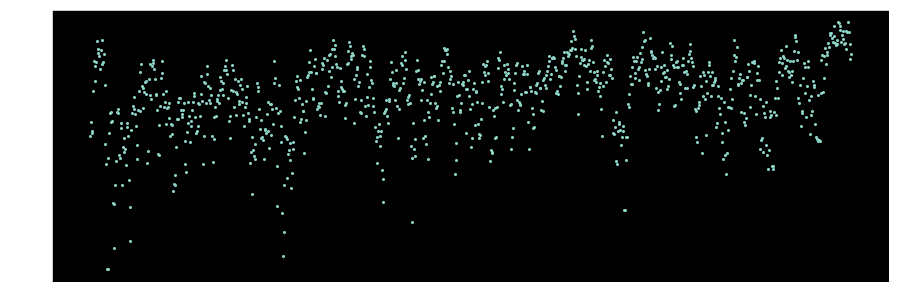

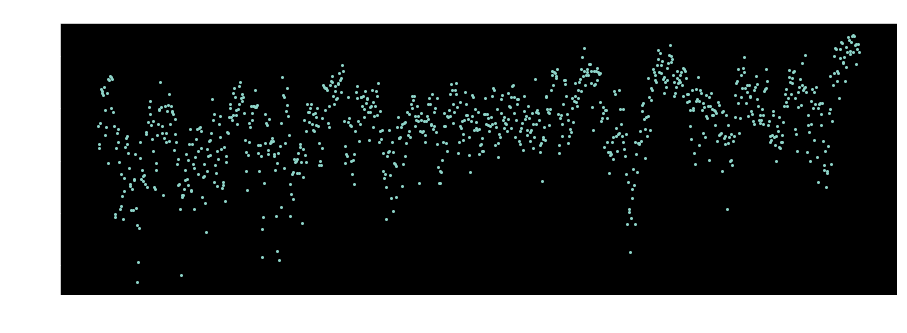

...

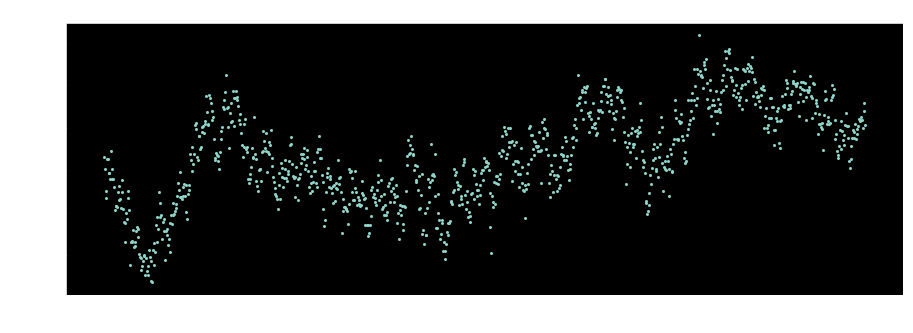

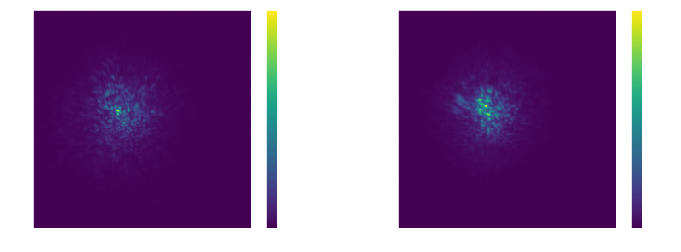

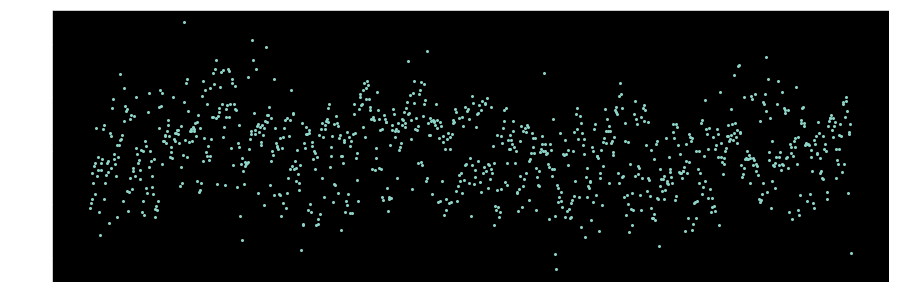

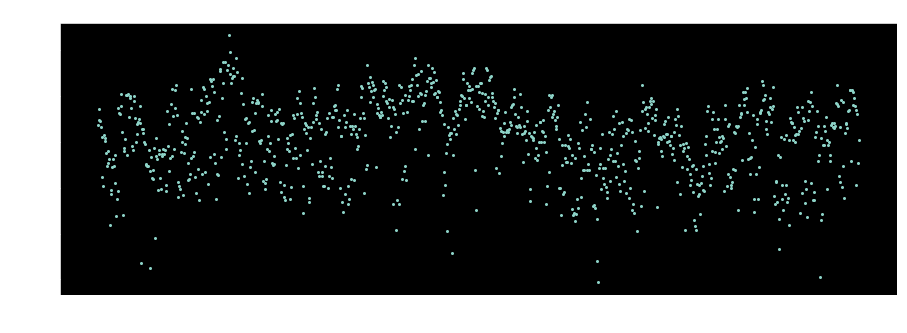

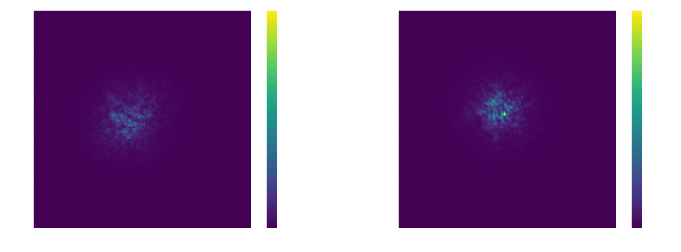

In [6]:
for file in fileNames:
    hdu = fits.open(scratchdir + 'rawSpeckles/' + file)
    series = hdu[0].data.astype('float64')
    hdu.close()

    plt.figure(figsize=(15,5))
    plt.plot(np.linspace(0,999,1000),series.sum(axis=1).sum(axis=1) / convWithGain[file],'o',ms=2)
    
    helper.subtractBackground(series)

    plt.figure(figsize=(15,5))
    plt.plot(np.linspace(0,999,1000),series.sum(axis=1).sum(axis=1) / convWithGain[file],'o',ms=2)
    plt.ylabel('image flux [photons]')
    plt.xlabel('exposure index')
    plt.title(file)
    plt.show()
    
    minid, maxid = np.argmin(series.sum(axis=1).sum(axis=1)), np.argmax(series.sum(axis=1).sum(axis=1))
    vmax = np.max(series[maxid])

    plt.figure(figsize=(12,4))
    plt.subplot(1,2,1)
    plt.imshow(series[minid], vmax=vmax)
    plt.colorbar()

    plt.subplot(1,2,2)
    plt.imshow(series[maxid], vmax=vmax)
    plt.colorbar();
    

## Average fluxes

In [7]:
fluxes = np.zeros(len(fileNames))
for i in range(len(fileNames)):
    file = fileNames[i]
    hdu = fits.open(scratchdir + 'rawSpeckles/' + file)
    series = hdu[0].data.astype('float64')
    hdu.close()

    helper.subtractBackground(series)
    
    fluxes[i] = series.sum() / (1000 * convWithGain[file])

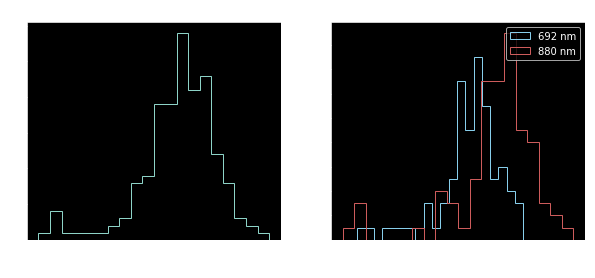

In [8]:
plt.figure(figsize=(10,4))
plt.subplot(121)
plt.title('both filters')
plt.hist(np.log10(fluxes), bins=20, histtype='step')
plt.xlabel('log average flux')

plt.subplot(122)
plt.hist(np.log10(fluxes[:int(len(fileNames)/2)]), bins=20, histtype='step', color='skyblue', label='692 nm')
plt.hist(np.log10(fluxes[int(len(fileNames)/2):]), bins=20, histtype='step', color='indianred', label='880 nm')
plt.xlabel('log average flux')
plt.legend()

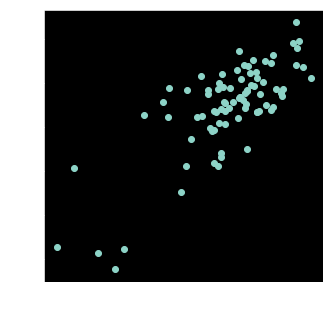

In [9]:
plt.figure(figsize=(5,5))
plt.plot(np.log10(fluxes[:int(len(fileNames)/2)]), np.log10(fluxes[int(len(fileNames)/2):]), 'o')
# plt.plot([5,8],[5,8],'--')
plt.xlabel('filter a: 692nm')
plt.ylabel('filter b: 880nm')
plt.show()